In [1]:
# Cell binning of 2 um bins using Bin2cell
# Author: github.com/acerch

# Following bin2cell demo notebooks: https://nbviewer.org/github/Teichlab/bin2cell/blob/main/
# notebooks/demo.ipynb and https://nbviewer.org/github/Teichlab/bin2cell/blob/main/notebooks/
# N1_demo_b2c_crc_submission.ipynb

# Data used available in 10X Genomics Data Base: 
# https://www.10xgenomics.com/datasets/visium-hd-cytassist-gene-expression-human-breast-cancer-fresh-frozen

In [2]:
# Import necessary libraries
import bin2cell as b2c
import matplotlib.pyplot as plt
import scanpy as sc
import numpy as np
import os
import scipy

import time
import psutil

# Create directory for stardist input/output files
os.makedirs("stardist", exist_ok=True)

In [3]:
# Initial time
start_time = time.time()
# Initial memory
process = psutil.Process(os.getpid())
start_mem = process.memory_info().rss / 1e6 # in MB 

In [4]:
# The required inputs are the 2um bin output and the spatial folder from spaceranger, 
# along with the high resolution morphology image that was used on input of SpaceRanger (passed via --image)

# Establish working path
datapath = "../../Data/Raw/raw_data_fresh_frozen/"

# Establish path binned outputs
path = datapath + "binned_outputs/square_002um/"

# Establish image path
source_image_path = datapath + "Visium_HD_Human_Breast_Cancer_Fresh_Frozen_tissue_image.tif"
spaceranger_image_path = datapath + "binned_outputs/square_002um/spatial"

In [5]:
# Import Visum data using bin2cell read_visium and create Anndata object

adata = b2c.read_visium(path, 
                        source_image_path = source_image_path, 
                        spaceranger_image_path = spaceranger_image_path
                       )
adata.var_names_make_unique()
adata

anndata.py (1758): Variable names are not unique. To make them unique, call `.var_names_make_unique`.
anndata.py (1758): Variable names are not unique. To make them unique, call `.var_names_make_unique`.


AnnData object with n_obs × n_vars = 7527250 × 18085
    obs: 'in_tissue', 'array_row', 'array_col'
    var: 'gene_ids', 'feature_types', 'genome'
    uns: 'spatial'
    obsm: 'spatial'

In [6]:
# Filter the object (gene apears min in 3 bins, and bins have any information, 
# the data is extremely sparse at this stage)
sc.pp.filter_genes(adata, min_cells=3)
sc.pp.filter_cells(adata, min_counts=1)

adata

AnnData object with n_obs × n_vars = 7505937 × 16746
    obs: 'in_tissue', 'array_row', 'array_col', 'n_counts'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells'
    uns: 'spatial'
    obsm: 'spatial'

In [7]:
# Stablish mpp (micros per pixel) parameter
mpp = 0.5

# Stablish a scaled image of the reference H&E image
b2c.scaled_he_image(adata, mpp=mpp, save_path="stardist/he.tiff")

Cropped spatial coordinates key: spatial_cropped_150_buffer
Image key: 0.5_mpp_150_buffer


In [8]:
# Correction of variable bin sizing (Visium HD presents a variable bin size when 
# printing the chips of around 10%) and count total visible striped appearance, 
# to fix it destripe function is used
b2c.destripe(adata)
adata

_construct.py (163): Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`


AnnData object with n_obs × n_vars = 7505937 × 16746
    obs: 'in_tissue', 'array_row', 'array_col', 'n_counts', 'destripe_factor', 'n_counts_adjusted'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells'
    uns: 'spatial'
    obsm: 'spatial', 'spatial_cropped_150_buffer'

In [9]:
# Inspect the object coordinates values, to determine the values for the crop image

print("The min values of array_row are:", adata.obs["array_row"].min())
print("The max values of array_row are:", adata.obs["array_row"].max())

print("The min values of array_col are:", adata.obs["array_col"].min())
print("The max values of array_col are:", adata.obs["array_col"].max())

The min values of array_row are: 337
The max values of array_row are: 3349
The min values of array_col are: 0
The max values of array_col are: 3310


3215440246.py (18): Use `squidpy.pl.spatial_scatter` instead.
anndata.py (1138): Trying to modify attribute `.var` of view, initializing view as actual.
anndata.py (1138): Trying to modify attribute `.var` of view, initializing view as actual.


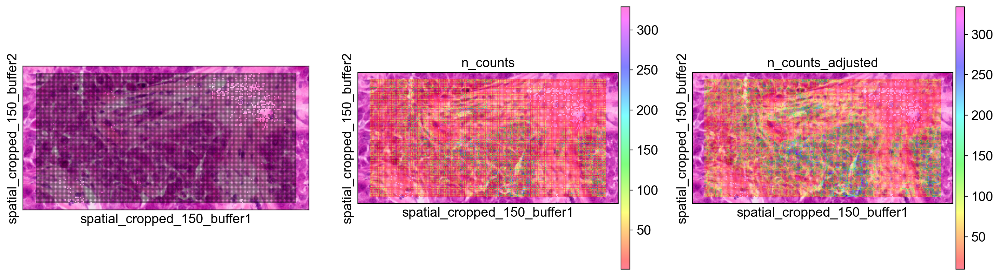

Prior to the adjustment, the count total has a visible striped appearance.The effect is diminished after the correction.


In [10]:
# Check fine grain allignment
# Define threshold
thr = 10

# Define a mask to easily pull out this region of the object in the future
mask = ((adata.obs['array_row'] >= 1450) & 
        (adata.obs['array_row'] <= 1550) & 
        (adata.obs['array_col'] >= 250) & 
        (adata.obs['array_col'] <= 450)
       )

# Read a crop of the object
bdata = adata[mask]
# Set parameters for figure
sc.set_figure_params(figsize=[5,5],dpi=100)
# Filter bdata by threshold
bdata = bdata[bdata.obs['n_counts_adjusted']>thr]
sc.pl.spatial(bdata, color=[None, "n_counts", "n_counts_adjusted"], color_map="gist_rainbow",
              alpha=0.5, img_key="0.5_mpp_150_buffer", basis="spatial_cropped_150_buffer")

print("Prior to the adjustment, the count total has a visible striped appearance." 
      "The effect is diminished after the correction.")

2609982848.py (3): Use `squidpy.pl.spatial_scatter` instead.


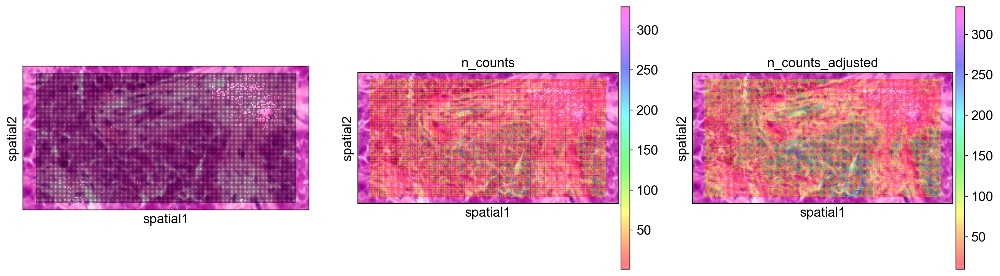

In [11]:
# Compare our custom high resolution H&E image versus the default one present in the spaceranger output. 
# The image we made is sharper, which is of particular relevance while working with the 2um bins.
sc.pl.spatial(bdata, color=[None, "n_counts", "n_counts_adjusted"], color_map="gist_rainbow", alpha=0.5)

3792580076.py (18): Use `squidpy.pl.spatial_scatter` instead.
anndata.py (1138): Trying to modify attribute `.var` of view, initializing view as actual.
anndata.py (1138): Trying to modify attribute `.var` of view, initializing view as actual.


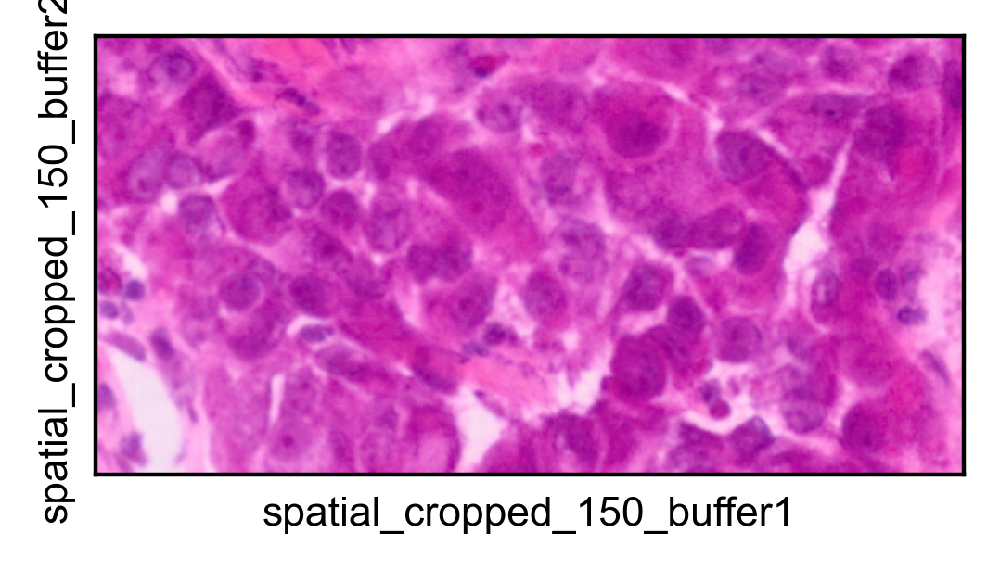

3792580076.py (19): Use `squidpy.pl.spatial_scatter` instead.


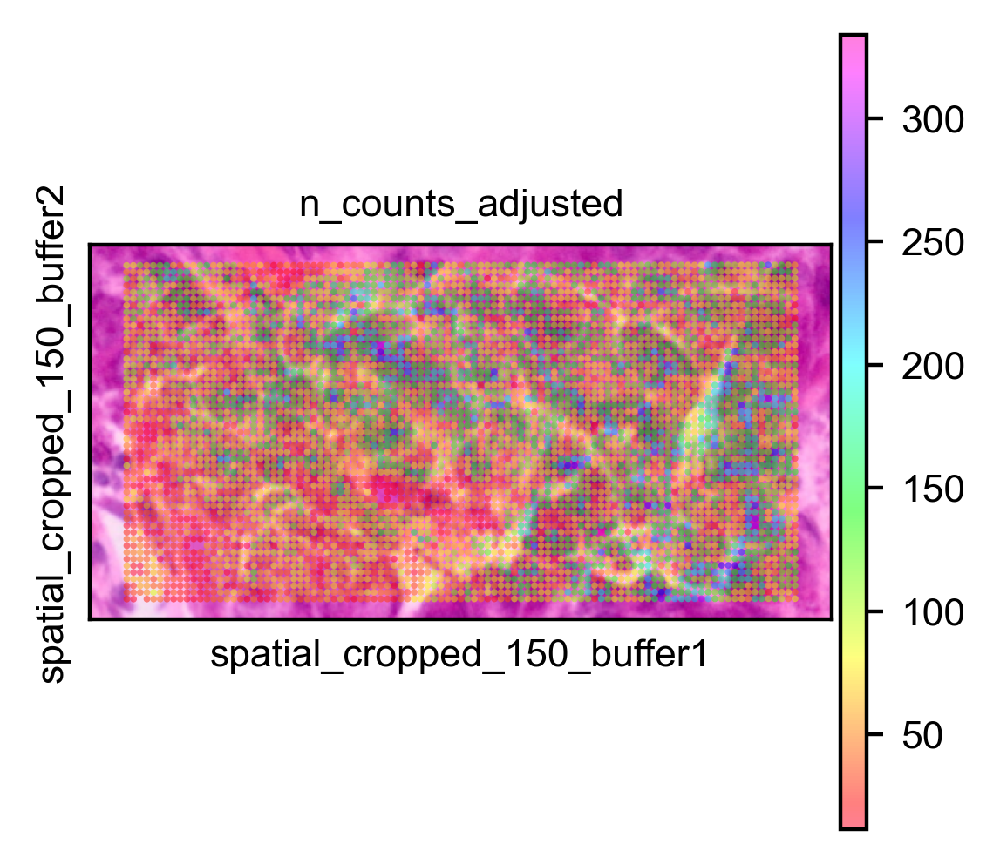

In [12]:
# Check on zoom tissue region, easier to evaluate if there is misaligment

# Define a mask of zzom to easily pull out this region of the object in the future
mask2 = ((adata.obs['array_row'] >= 1500) & 
        (adata.obs['array_row'] <= 1550) & 
        (adata.obs['array_col'] >= 310) & 
        (adata.obs['array_col'] <= 410)
       )

# Read a crop of the object
bdata2 = adata[mask2]

# Filter bdata by threshold
bdata2 = bdata2[bdata2.obs['n_counts_adjusted']>thr]

# Visualise if there is misalignment in zoom tissue image
sc.set_figure_params(figsize=[3,3],dpi=200, fontsize=8)
sc.pl.spatial(bdata2, color=None, img_key="0.5_mpp_150_buffer", basis="spatial_cropped_150_buffer",alpha=0)
sc.pl.spatial(bdata2, color="n_counts_adjusted", img_key="0.5_mpp_150_buffer", 
              basis="spatial_cropped_150_buffer", alpha=0.5,cmap='gist_rainbow')


In [13]:
print("Visualising the expression matrix over the tissue allows to evaluate if there is misaligment.\n"
"As observed in the detail image above, generally the bins with higher counts align with the\ntinted nuclei, " 
"and the light colored spaces (that could represent stroma or fat tissue)\nrepresent less expression.\n")

Visualising the expression matrix over the tissue allows to evaluate if there is misaligment.
As observed in the detail image above, generally the bins with higher counts align with the
tinted nuclei, and the light colored spaces (that could represent stroma or fat tissue)
represent less expression.



1034399101.py (18): Use `squidpy.pl.spatial_scatter` instead.
anndata.py (1138): Trying to modify attribute `.var` of view, initializing view as actual.
anndata.py (1138): Trying to modify attribute `.var` of view, initializing view as actual.


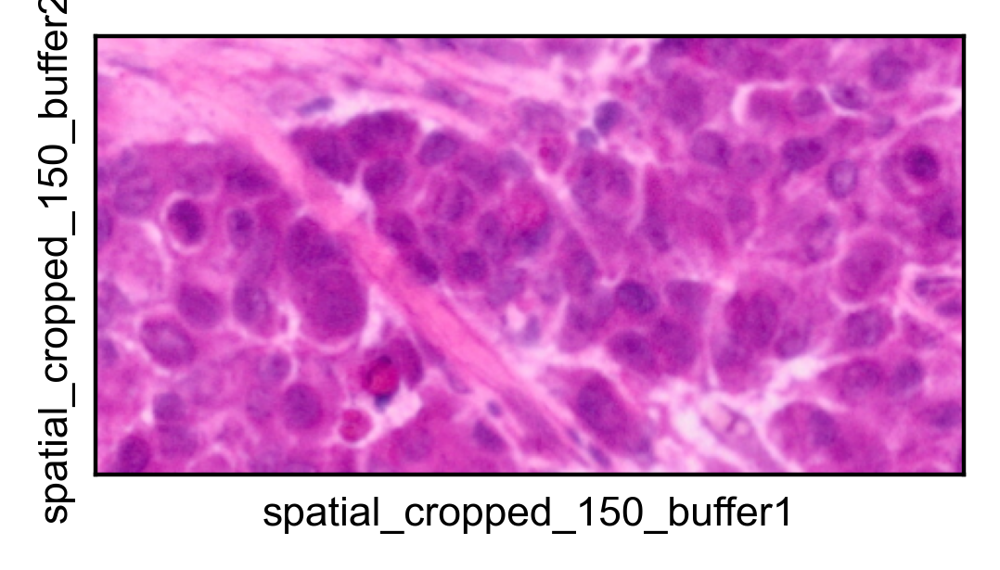

1034399101.py (19): Use `squidpy.pl.spatial_scatter` instead.


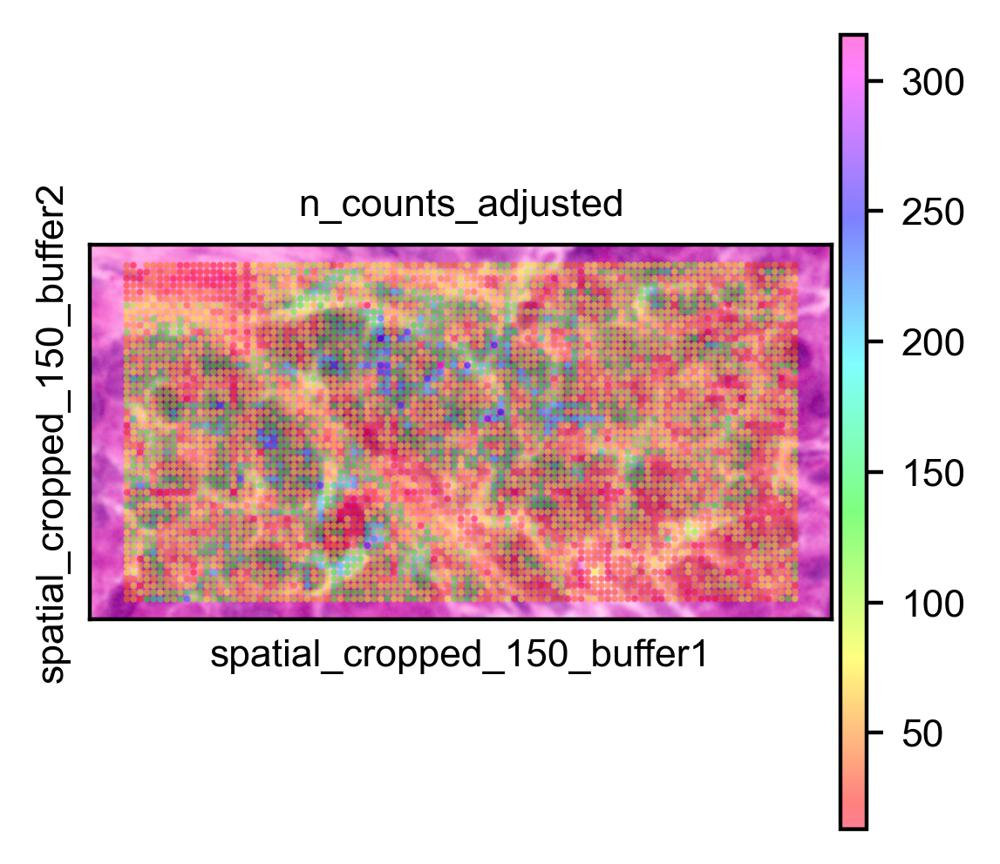

In [14]:
# Check if in other tissue region same results are observed

# Define a mask to easily pull out this region of the object in the future
mask3 = ((adata.obs['array_row'] >= 2500) & 
        (adata.obs['array_row'] <= 2550) & 
        (adata.obs['array_col'] >= 610) & 
        (adata.obs['array_col'] <= 710)
       )

# Read a crop of the object
bdata3 = adata[mask3]

# Filter bdata by threshold
bdata3 = bdata3[bdata3.obs['n_counts_adjusted']>thr]

# Visualise if there is misalignment in zoom tissue image
sc.set_figure_params(figsize=[3,3],dpi=200, fontsize=8)
sc.pl.spatial(bdata3, color=None, img_key="0.5_mpp_150_buffer", basis="spatial_cropped_150_buffer",alpha=0)
sc.pl.spatial(bdata3, color="n_counts_adjusted", img_key="0.5_mpp_150_buffer", 
              basis="spatial_cropped_150_buffer",alpha=0.5,cmap='gist_rainbow')

In [15]:
print("As observed in the previous tissue region evaluated, it is determined that there is not "
      "apparent misaligment between\nthe expression matrix and the image, for this reason it is "
      "decided not to shift the coordinates in this pipeline.\nIf there was a misaligment, the next " 
      "steps could be used for manual aligment:")

As observed in the previous tissue region evaluated, it is determined that there is not apparent misaligment between
the expression matrix and the image, for this reason it is decided not to shift the coordinates in this pipeline.
If there was a misaligment, the next steps could be used for manual aligment:


In [16]:
# Adjusting slightly shift in coordinates 
#bdata = adata[mask] # read a crop of the object 
#b2c.scaled_he_image(bdata, mpp=mpp) # genertae a ref H&E only from th region of interest 
#right_left = +0 # (-) to move background image left, (+) to right 
#up_down = -5 # (-) to move background image down, (+) to move image up  
#bdata.obsm['spatial_cropped_150_buffer'][:,1] = bdata.obsm['spatial_cropped_150_buffer'][:,1] + up_down
#bdata.obsm['spatial_cropped_150_buffer'][:,0] = bdata.obsm['spatial_cropped_150_buffer'][:,0] + right_left

# Visualise the adjustment
#sc.set_figure_params(figsize=[5,5],dpi=200)
#bdata = bdata[bdata.obs['n_counts_adjusted']>thr]
#sc.pl.spatial(bdata, color=[None, "n_counts_adjusted"], img_key="0.5_mpp_150_buffer", basis="spatial_cropped_150_buffer",
#alpha=0.5,cmap='gist_rainbow')

# If right shift found, apply it to the full object as well  
#adata.obsm['spatial'][:,1] = adata.obsm['spatial'][:,1] + up_down
#adata.obsm['spatial'][:,0] = adata.obsm['spatial'][:,0] + right_left

In [17]:
# To verify this, check the coordenates vs image dimension, to confirm scaling and orientation are correct
# Check spatial coordinates 
coordinates = adata.obsm["spatial_cropped_150_buffer"]

# Check image array
image = adata.uns["spatial"]["Visium_HD_Human_Breast_Cancer_Fresh_Frozen"]["images"]["0.5_mpp_150_buffer"]

# Check image scale factors
scale_factor = adata.uns["spatial"]["Visium_HD_Human_Breast_Cancer_Fresh_Frozen"]["scalefactors"]["tissue_0.5_mpp_150_buffer_scalef"]

# Compare image dimensions with x,y coordinates 
print("The image (0.5_mpp_150_buffer) dimensions are:", image.shape) # height, width, channels 

print("Max coordinates are:", coordinates.max(axis=0))

x_image = coordinates.max(axis=0) * scale_factor
coordinates_scaled = coordinates * scale_factor

print("Taking into account the scale factor, the coordinates are:", x_image) #  width, height

The image (0.5_mpp_150_buffer) dimensions are: (12215, 13409, 3)
Max coordinates are: [24334.97543204 22155.49285719]
Taking into account the scale factor, the coordinates are: [13327.61862348 12133.97400135]


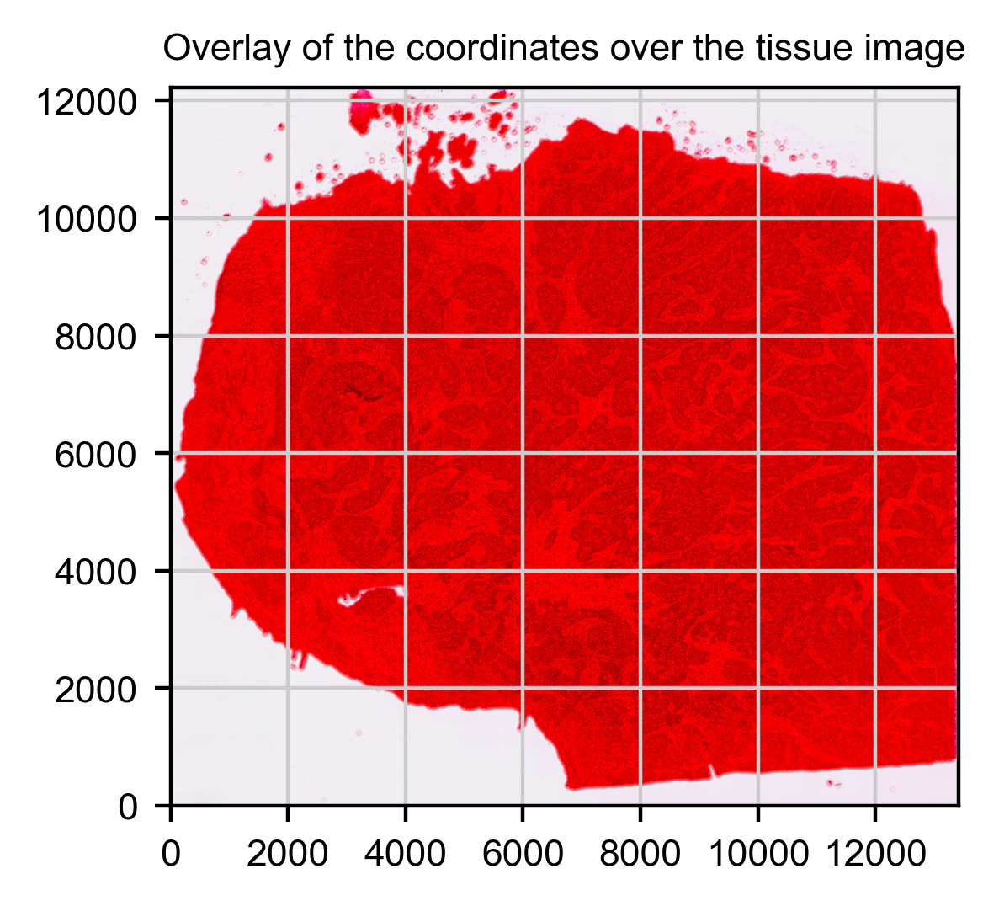

<Figure size 400x400 with 0 Axes>

In [18]:
# Visualise overlay of the coordinates over the tissue image
plt.imshow(image)
plt.scatter(coordinates_scaled[:, 0], coordinates_scaled[:, 1], alpha=0.05, s=0.001, c='red')
plt.gca().invert_yaxis()
plt.axis("on")
plt.title("Overlay of the coordinates over the tissue image")
plt.figure(figsize=(2,2))
plt.show()

In [19]:
print("As observed in the overlay of the coordinates over the tissue image\nthere is "
      "not apparent misalignment. For this reason it is decided\nto continue the "
      "downstream analysis with this adata object.")

As observed in the overlay of the coordinates over the tissue image
there is not apparent misalignment. For this reason it is decided
to continue the downstream analysis with this adata object.


In [20]:
# Perform H&E segmentation with StarDist's H&E model
b2c.stardist(image_path="stardist/he.tiff", 
             labels_npz_path="stardist/he.npz", 
             stardist_model="2D_versatile_he", 
             prob_thresh=0.01
            )

Found model '2D_versatile_he' for 'StarDist2D'.
Loading network weights from 'weights_best.h5'.
Loading thresholds from 'thresholds.json'.
Using default values: prob_thresh=0.692478, nms_thresh=0.3.
effective: block_size=(4096, 4096, 3), min_overlap=(128, 128, 0), context=(128, 128, 0)


100%|██████████████████████████████████████████████████████████████████████████████████| 16/16 [05:09<00:00, 19.36s/it]


Found 179840 objects


In [21]:
# Read the segmentation results sparse matrix 
scipy.sparse.load_npz("stardist/he.npz")

<Compressed Sparse Row sparse matrix of dtype 'int32'
	with 35599269 stored elements and shape (12215, 13409)>

In [22]:
# Load the resulting cell calls into the adata object
b2c.insert_labels(adata, 
                  labels_npz_path="stardist/he.npz", 
                  basis="spatial", 
                  spatial_key="spatial_cropped_150_buffer",
                  mpp=mpp, 
                  labels_key="labels_he"
                 )

# Save adata object
adata.write("b2c_adata.h5ad")
adata

AnnData object with n_obs × n_vars = 7505937 × 16746
    obs: 'in_tissue', 'array_row', 'array_col', 'n_counts', 'destripe_factor', 'n_counts_adjusted', 'labels_he'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells'
    uns: 'spatial', 'bin2cell'
    obsm: 'spatial', 'spatial_cropped_150_buffer'

2505447115.py (8): Trying to modify attribute `.obs` of view, initializing view as actual.
2505447115.py (11): Use `squidpy.pl.spatial_scatter` instead.


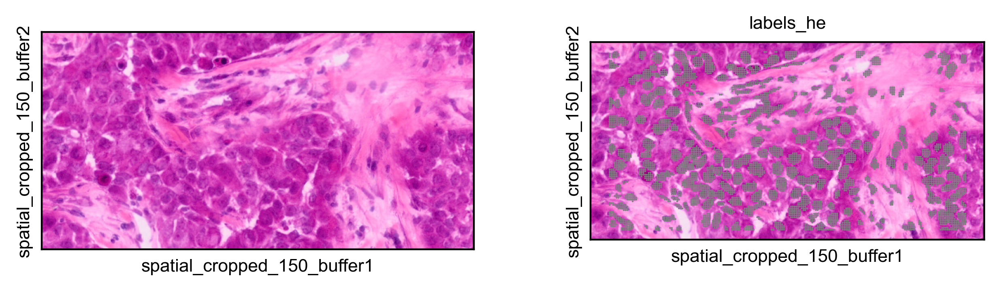

In [23]:
# Visualise the nuclear H&E segmentation on selected region bdata

# Recalculate bdata with new adata
bdata = adata[mask]

# Filter the labels obs, they are integers, 0 means unassigned
bdata = bdata[bdata.obs['labels_he']>0]
bdata.obs['labels_he'] = bdata.obs['labels_he'].astype(str)

# Visualise the nuclei identification in the H&E image
sc.pl.spatial(bdata, color=[None, "labels_he"], img_key="0.5_mpp_150_buffer", 
              basis="spatial_cropped_150_buffer", legend_loc="none")

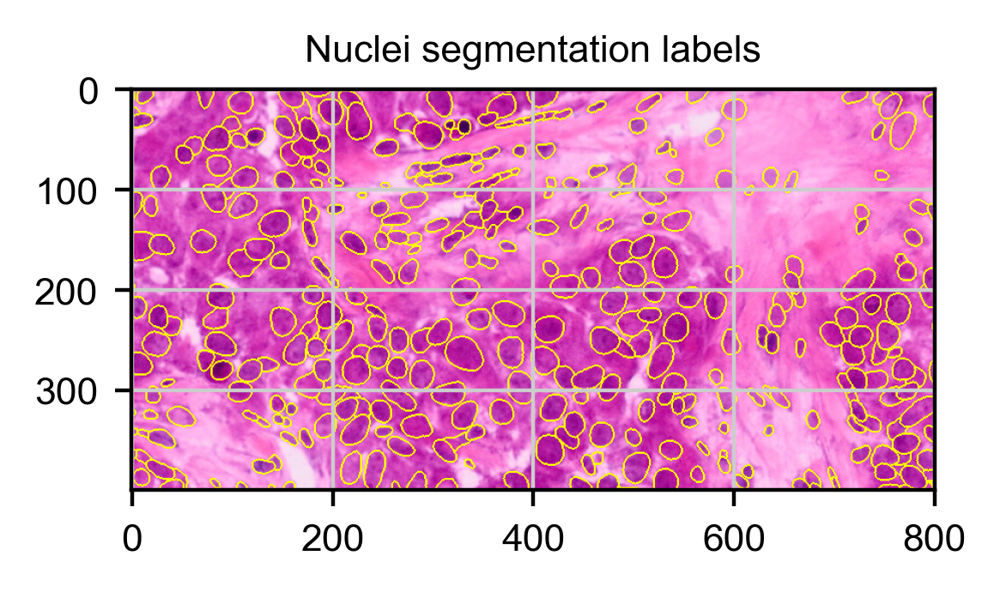

In [24]:
# Visualise the segmentation labels on a crop the input image

# Crop the input image 
crop = b2c.get_crop(bdata, basis="spatial", spatial_key="spatial_cropped_150_buffer", mpp=mpp)

rendered = b2c.view_labels(image_path="stardist/he.tiff", 
                           labels_npz_path="stardist/he.npz", 
                           crop=crop
                          )
# Visualise the image with the nuclei selection
plt.title("Nuclei segmentation labels")
plt.imshow(rendered)

In [25]:
# StarDist's H&E segmentation merely identifies nuclei, while there's more to a cell than just the nucleus.
# Expand the label to include the complete cell. The expanded labels capture more bins.
b2c.expand_labels(adata, 
                  labels_key='labels_he', 
                  expanded_labels_key="labels_he_expanded"
                 )

# Save adata object
adata.write("b2c_adata.h5ad")
adata

AnnData object with n_obs × n_vars = 7505937 × 16746
    obs: 'in_tissue', 'array_row', 'array_col', 'n_counts', 'destripe_factor', 'n_counts_adjusted', 'labels_he', 'labels_he_expanded'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells'
    uns: 'spatial', 'bin2cell'
    obsm: 'spatial', 'spatial_cropped_150_buffer'

720216231.py (7): Trying to modify attribute `.obs` of view, initializing view as actual.
720216231.py (9): Use `squidpy.pl.spatial_scatter` instead.


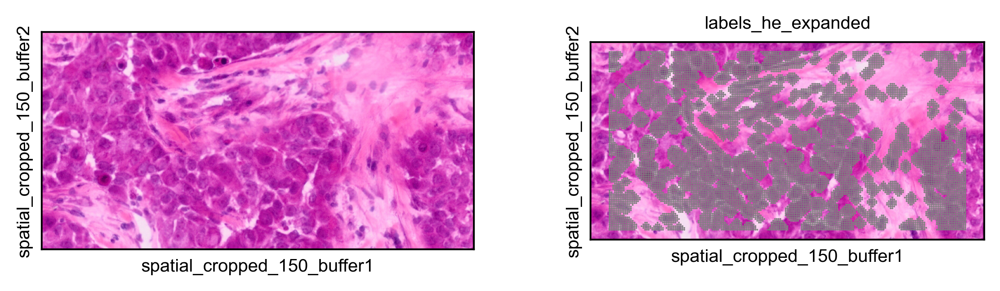

In [26]:
# Visualisation of the nuclear H&E segmentation on selected region bdata with expanded labels (whole cell)
# Recalculate bdata with new adata
bdata = adata[mask]

# Filter the labels obs, they are integers, 0 means unassigned
bdata = bdata[bdata.obs['labels_he_expanded']>0]
bdata.obs['labels_he_expanded'] = bdata.obs['labels_he_expanded'].astype(str)

sc.pl.spatial(bdata, color=[None, "labels_he_expanded"], img_key="0.5_mpp_150_buffer", 
              basis="spatial_cropped_150_buffer", legend_loc="none")

In [27]:
# The H&E segmentation is not guaranteed to be perfect. There may be some regions that have 
# expression data but lack a visible nuclei to seed a cell. Alternately, nuclei may take on 
# unusual shapes and not be detected by the model. 
# Performing segmentation on a representation of total expression per bin may be able to detect
# some of the missed cells.
# Limitation: struggles to differentiate individual cells in dense regions.

# Create the input image 
# The input image is going to be a representation of the total counts per bin, with a Gaussian 
# filter with a sigma of 5 
# (measured in pixels) applied for a little smoothing.
b2c.grid_image(adata, "n_counts_adjusted", mpp=mpp, sigma=5, save_path="stardist/gex.tiff")

In [28]:
# The segmentation is performed via StarDist's fluorescence model, and identifies cells
# rather than nuclei, meaning subsequent label expasion is not necessary. 

# Perform new segmentation 
b2c.stardist(image_path="stardist/gex.tiff", 
             labels_npz_path="stardist/gex.npz", 
             stardist_model="2D_versatile_fluo", 
             prob_thresh=0.05, 
             nms_thresh=0.5
            )

Found model '2D_versatile_fluo' for 'StarDist2D'.
Loading network weights from 'weights_best.h5'.
Loading thresholds from 'thresholds.json'.
Using default values: prob_thresh=0.479071, nms_thresh=0.3.
effective: block_size=(4096, 4096), min_overlap=(128, 128), context=(128, 128)


100%|██████████████████████████████████████████████████████████████████████████████████| 16/16 [04:33<00:00, 17.10s/it]


Found 60093 objects


In [29]:
# Load resulting calls in adata object like the H&E ones were, except the input image was based on 
# array rather than spatial coordinates.
b2c.insert_labels(adata, 
                  labels_npz_path="stardist/gex.npz", 
                  basis="array", 
                  mpp=mpp, 
                  labels_key="labels_gex"
                 )
# Save adata object
adata.write("b2c_adata.h5ad")
adata

AnnData object with n_obs × n_vars = 7505937 × 16746
    obs: 'in_tissue', 'array_row', 'array_col', 'n_counts', 'destripe_factor', 'n_counts_adjusted', 'labels_he', 'labels_he_expanded', 'labels_gex'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells'
    uns: 'spatial', 'bin2cell'
    obsm: 'spatial', 'spatial_cropped_150_buffer'

380776418.py (7): Trying to modify attribute `.obs` of view, initializing view as actual.
380776418.py (10): Use `squidpy.pl.spatial_scatter` instead.


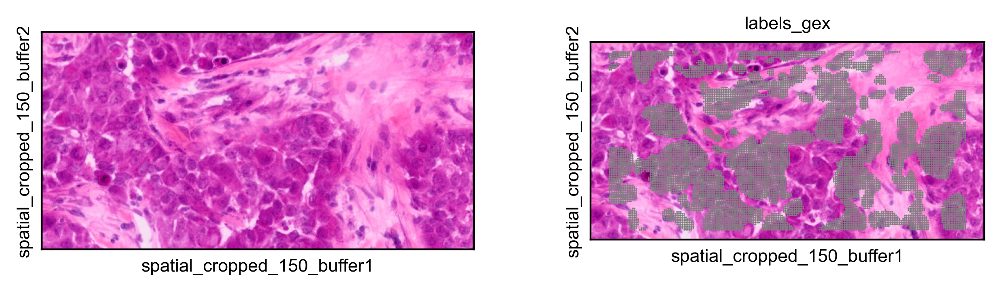

In [30]:
# Visualise the cells identified in the GEX space segmentation in the previously defined region.
# Recalculate bdata with new adata
bdata = adata[mask]

# Filter the labels obs, they are integers, 0 means unassigned
bdata = bdata[bdata.obs['labels_gex']>0]
bdata.obs['labels_gex'] = bdata.obs['labels_gex'].astype(str)

# Visualise in the tissue
sc.pl.spatial(bdata, color=[None, "labels_gex"], img_key="0.5_mpp_150_buffer",
              basis="spatial_cropped_150_buffer", legend_loc="none")

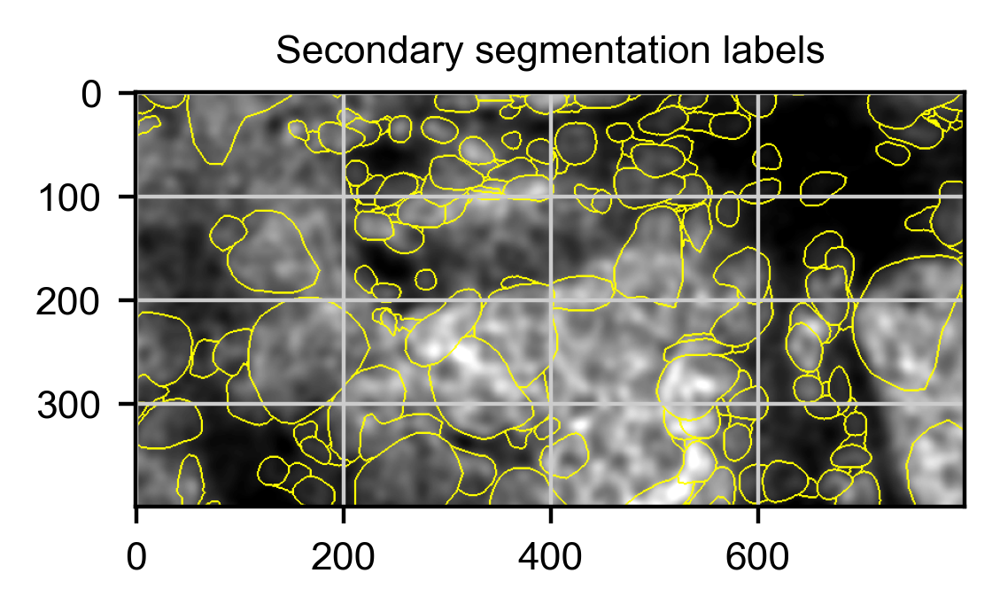

In [31]:
# Visualise the segmentation results on a crop the input image

# Crop the input image 
crop = b2c.get_crop(bdata, basis="array", mpp=mpp)

# Run normmalizaction, GEX pops better with percentile normalisation performed
rendered = b2c.view_labels(image_path="stardist/gex.tiff", 
                           labels_npz_path="stardist/gex.npz", 
                           crop=crop,
                           stardist_normalize=True
                          )
# Visualise the image with the cell selection with GEX
plt.title("Secondary segmentation labels")
plt.imshow(rendered)

In [32]:
# Fill in the gaps in the H&E with GEX calls.
# Add GEX cells that do not overlap with any H&E labels.
b2c.salvage_secondary_labels(adata, 
                             primary_label="labels_he_expanded", 
                             secondary_label="labels_gex", 
                             labels_key="labels_joint"
                            )

# Save adata object
adata.write("b2c_adata.h5ad")
adata

Salvaged 3251 secondary labels


AnnData object with n_obs × n_vars = 7505937 × 16746
    obs: 'in_tissue', 'array_row', 'array_col', 'n_counts', 'destripe_factor', 'n_counts_adjusted', 'labels_he', 'labels_he_expanded', 'labels_gex', 'labels_joint', 'labels_joint_source'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells'
    uns: 'spatial', 'bin2cell'
    obsm: 'spatial', 'spatial_cropped_150_buffer'

4224274394.py (7): Trying to modify attribute `.obs` of view, initializing view as actual.
4224274394.py (10): Use `squidpy.pl.spatial_scatter` instead.


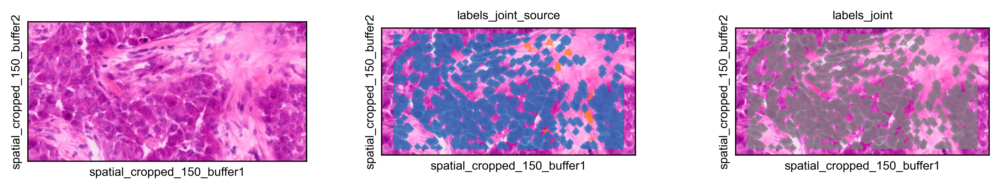

In [33]:
# Visualise the joined data from both labellings 
# Recalculate bdata with new adata
bdata = adata[mask]

# Filter the labels obs, they are integers, 0 means unassigned
bdata = bdata[bdata.obs['labels_joint']>0]
bdata.obs['labels_joint'] = bdata.obs['labels_joint'].astype(str)

# Visualise images
sc.pl.spatial(bdata, color=[None, "labels_joint_source", "labels_joint"], 
              img_key="0.5_mpp_150_buffer", basis="spatial_cropped_150_buffer", 
              legend_loc="none")

In [34]:
# At this point, the counts have been destriped and bins have been assigned
# to cells based on both H&E and GEX segmentation.
# Group the bins into cells creating cdata object 
cdata = b2c.bin_to_cell(adata, labels_key="labels_joint", spatial_keys=["spatial", "spatial_cropped_150_buffer"])

# Save cdata object
cdata.write_h5ad("b2c_cdata.h5ad")
cdata

AnnData object with n_obs × n_vars = 182540 × 16746
    obs: 'object_id', 'bin_count', 'array_row', 'array_col', 'labels_joint_source'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells'
    uns: 'spatial'
    obsm: 'spatial', 'spatial_cropped_150_buffer'

1870671083.py (11): Use `squidpy.pl.spatial_scatter` instead.
_utils.py (487): Trying to modify attribute `._uns` of view, initializing view as actual.


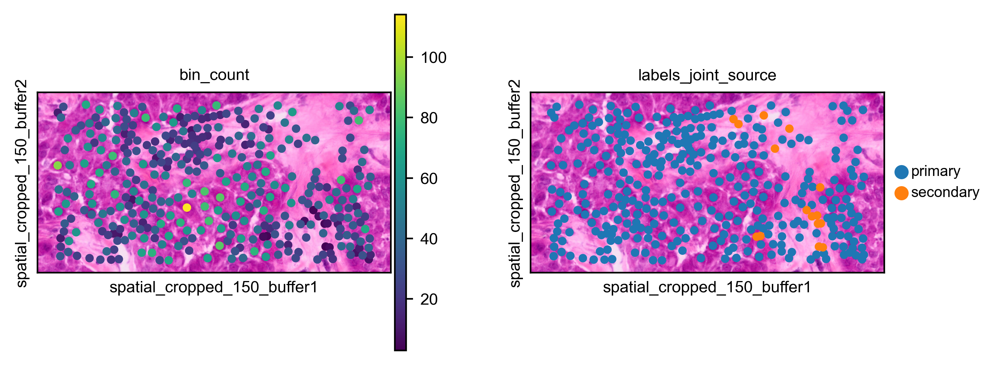

In [35]:
# Visualise our test fragment of the tissue, now in cell space
cell_mask = ((cdata.obs['array_row'] >= 1450) & 
             (cdata.obs['array_row'] <= 1550) & 
             (cdata.obs['array_col'] >= 250) & 
             (cdata.obs['array_col'] <= 450)
            )

ddata = cdata[cell_mask]

# Visualise images
sc.pl.spatial(ddata, color=["bin_count", "labels_joint_source"], 
              img_key="0.5_mpp_150_buffer", basis="spatial_cropped_150_buffer")

In [36]:
# Save the AnnData object
adata.write_h5ad(datapath + "../../Processed/2um_breastFF.h5ad")
adata

AnnData object with n_obs × n_vars = 7505937 × 16746
    obs: 'in_tissue', 'array_row', 'array_col', 'n_counts', 'destripe_factor', 'n_counts_adjusted', 'labels_he', 'labels_he_expanded', 'labels_gex', 'labels_joint', 'labels_joint_source'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells'
    uns: 'spatial', 'bin2cell'
    obsm: 'spatial', 'spatial_cropped_150_buffer'

In [37]:
# Save the AnnData object for further analysis
cdata.write_h5ad(datapath + "../../Processed/b2c_breastFF.h5ad")
cdata

AnnData object with n_obs × n_vars = 182540 × 16746
    obs: 'object_id', 'bin_count', 'array_row', 'array_col', 'labels_joint_source'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells'
    uns: 'spatial'
    obsm: 'spatial', 'spatial_cropped_150_buffer'

In [38]:
print("After the Bin2Cell segmentations H&E and GEX", cdata.n_obs, "cells were obtained, and", cdata.n_vars, 
      "genes are represented in the object.\nThis data (cdata AnnData object) will be used in Scanpy "
      "for the downstream analysis as single-cell data.")

After the Bin2Cell segmentations H&E and GEX 182540 cells were obtained, and 16746 genes are represented in the object.
This data (cdata AnnData object) will be used in Scanpy for the downstream analysis as single-cell data.


In [39]:
# End time 
end_time = time.time() 
elapsed_time = end_time - start_time 

# Print results
print(f"Total time: {elapsed_time: .2f} seconds") 

Total time:  963.12 seconds


In [40]:
# Calculate memory information
memory = psutil.virtual_memory()
# Convert Bytes to MB (Bytes -> KB -> MB)
available = round(memory.available/1024.0/1024.0,1)
total = round(memory.total/1024.0/1024.0,1)
mem_info = str(available) + 'MB free / ' + str(total) + 'MB total ( ' + str(memory.percent) + '% used )'
# Print results
print(mem_info)

6302.4MB free / 32674.9MB total ( 80.7% used )
